# Mask R-CNN - Inspect Homes Trained Model

Code and visualizations to test, debug, and evaluate the Mask R-CNN model.

In [46]:
import os
import sys
import random
import math
import re
import time
import numpy as np
import tensorflow as tf
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import skimage.draw

# Root directory of the project
ROOT_DIR = os.path.abspath("../../")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
import mrcnn
from mrcnn import utils
from mrcnn import visualize
from mrcnn.visualize import display_images
import mrcnn.model as modellib
from mrcnn.model import log

from samples.homes import homes

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")
image_path = os.path.join(ROOT_DIR, "../data/homes/test_input")

## Configurations

In [47]:
config = homes.HomesConfig()

In [48]:
# Override the training configurations with a few
# changes for inferencing.
class InferenceConfig(config.__class__):
    # Run detection on one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

config = InferenceConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.9
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                20
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'mrcnn_class_loss': 1.0, 'mrcnn_mask_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'rpn_bbox_loss': 1.0, 'rpn_class_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

## Notebook Preferences

In [49]:
# Device to load the neural network on.
# Useful if you're training a model on the same 
# machine, in which case use CPU and leave the
# GPU for training.
DEVICE = "/gpu:0"  # /cpu:0 or /gpu:0

# Inspect the model in training or inference modes
# values: 'inference' or 'training'
# TODO: code for 'training' test mode not ready yet
TEST_MODE = "inference"

In [50]:
def get_ax(rows=1, cols=1, size=16):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Adjust the size attribute to control how big to render images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

## Load Model

In [51]:
# Create model in inference mode
with tf.device(DEVICE):
    model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR,
                              config=config)

In [52]:
# Or, load the last model you trained
weights_path = model.find_last()

# Load weights
print("Loading weights ", weights_path)
model.load_weights(weights_path, by_name=True)

Loading weights  /home/dushu/github/Mask_RCNN/logs/homes20190207T0550/mask_rcnn_homes_0030.h5
Re-starting from epoch 30


## Run Detection

Running on 169.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 148.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 1.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 125.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 107.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 171.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 115.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 229.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 247.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 232.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 284.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 117.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 170.jpg
Processing 1 images
image
molded_im

/home/dushu/anaconda3/envs/tensorflow/lib/python3.5/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Running on 357.jpg
Processing 1 images
image
molded_images
image_metas
anchors

*** No instances to display *** 

Running on 250.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 39.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 31.jpg
Processing 1 images
image
molded_images
image_metas
anchors

*** No instances to display *** 

Running on 118.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 40.jpg
Processing 1 images
image
molded_images
image_metas
anchors

*** No instances to display *** 

Running on 352.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 338.jpg
Processing 1 images
image
molded_images
image_metas
anchors

*** No instances to display *** 

Running on 408.jpg
Processing 1 images
image
molded_images
image_metas
anchors

*** No instances to display *** 

Running on 405.jpg
Processing 1 images
image
molded_images
image_metas
anchors
Running on 435.jpg
Processing 1 images

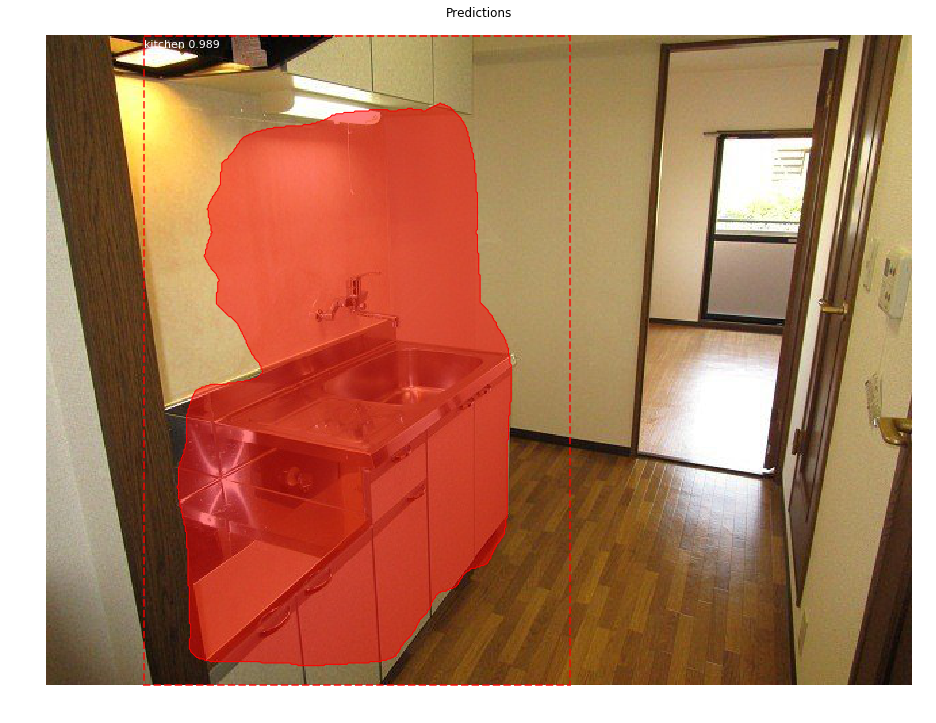

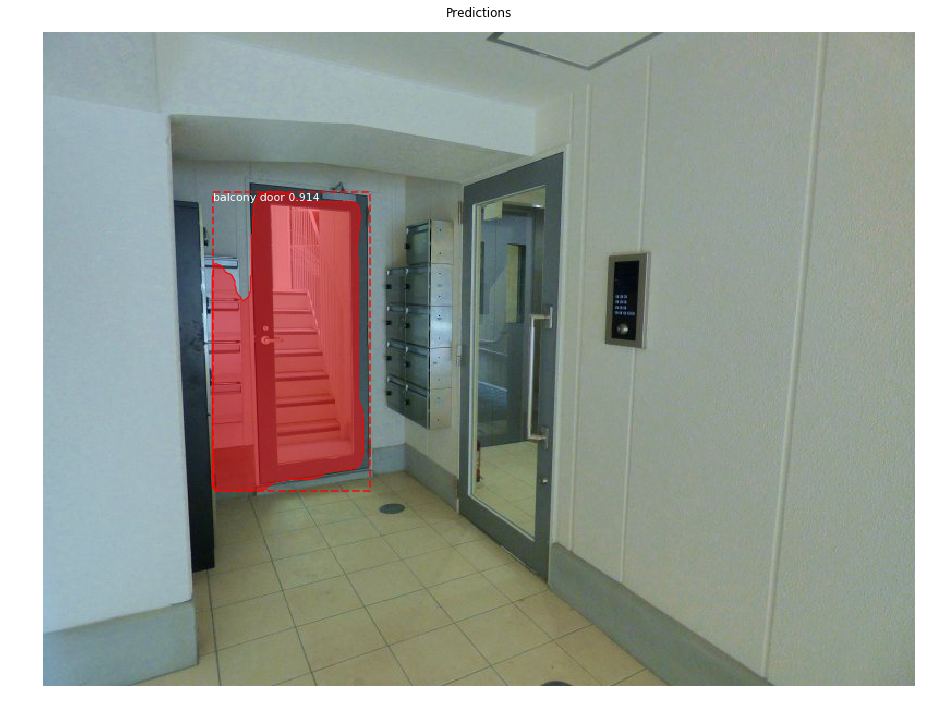

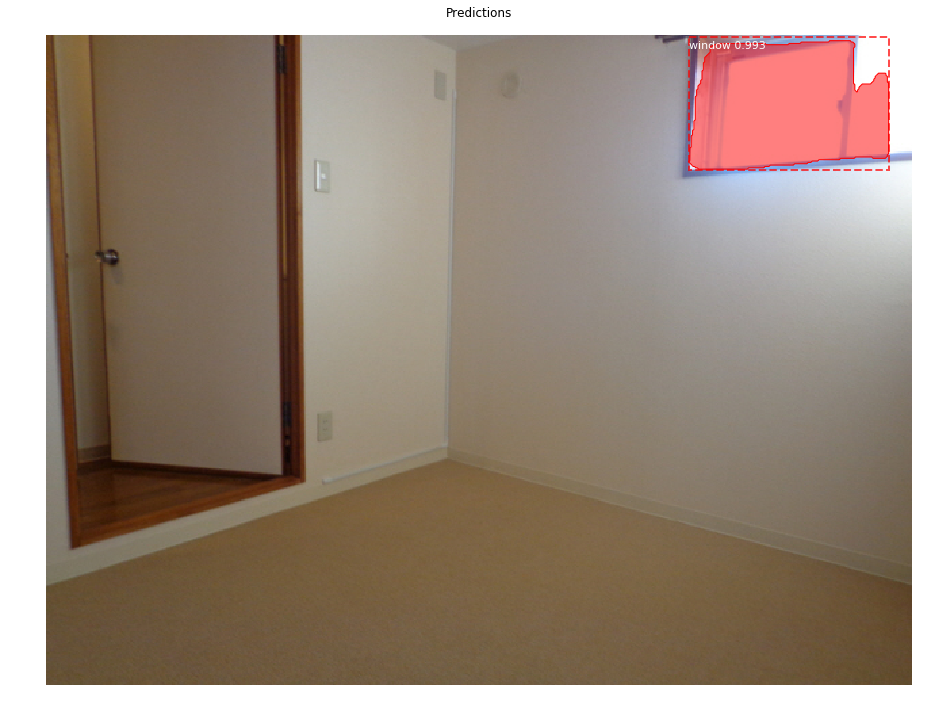

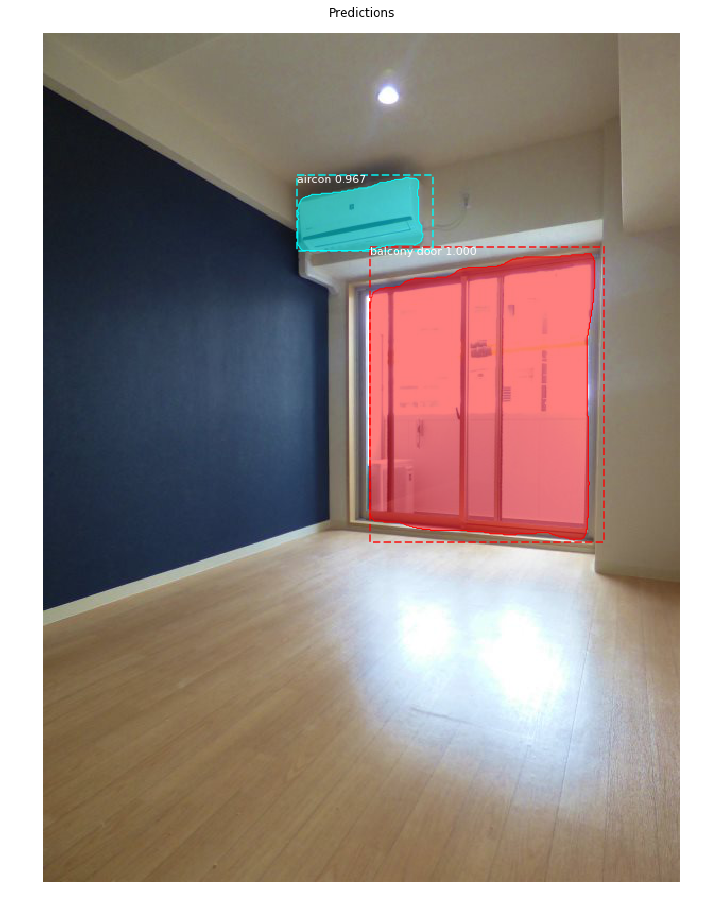

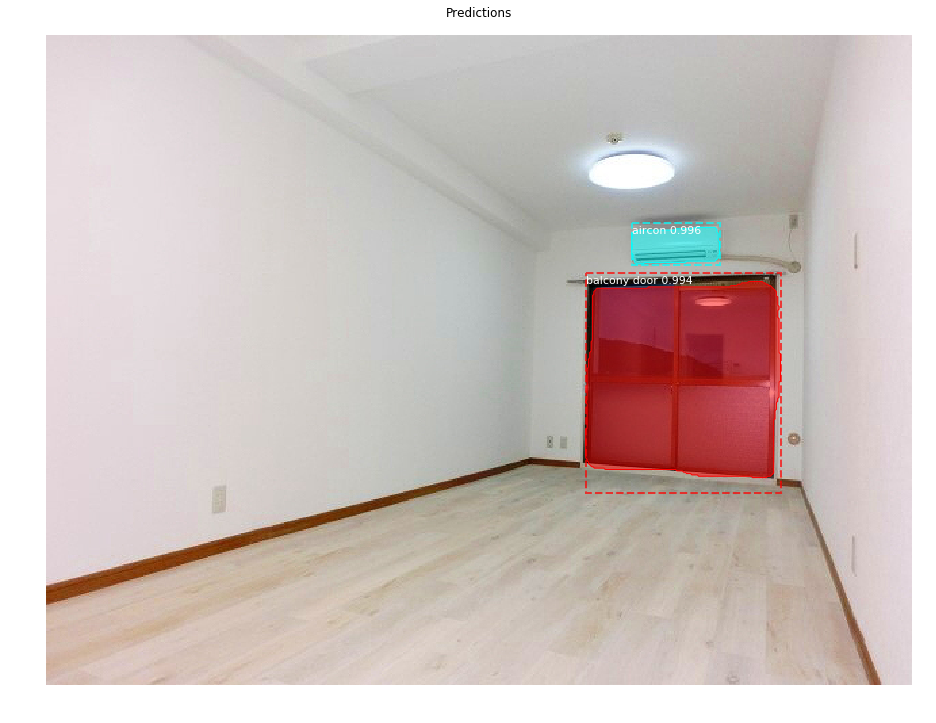

...

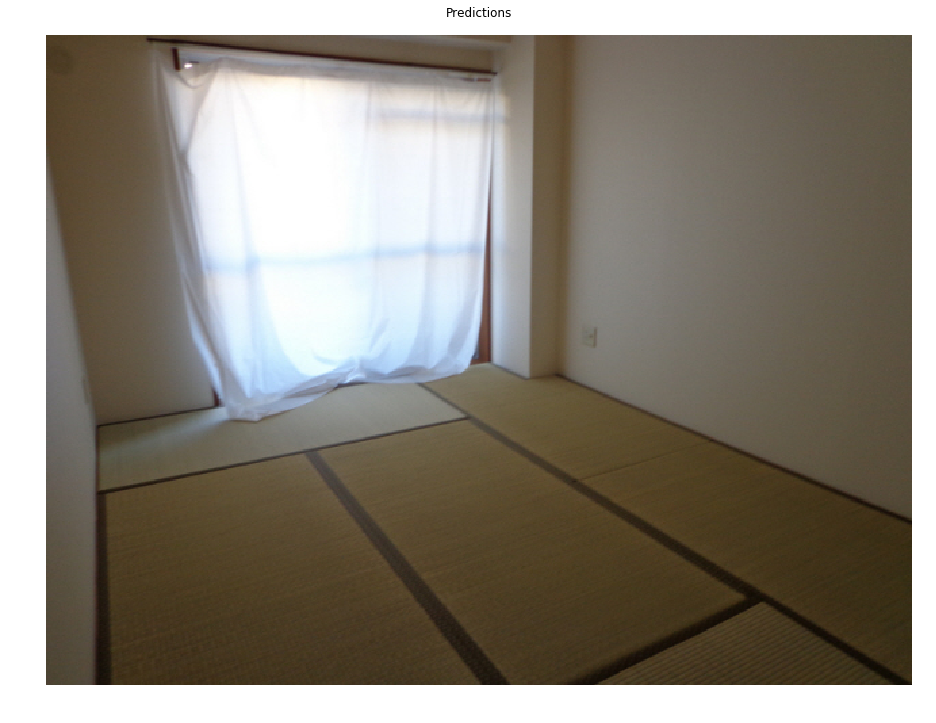

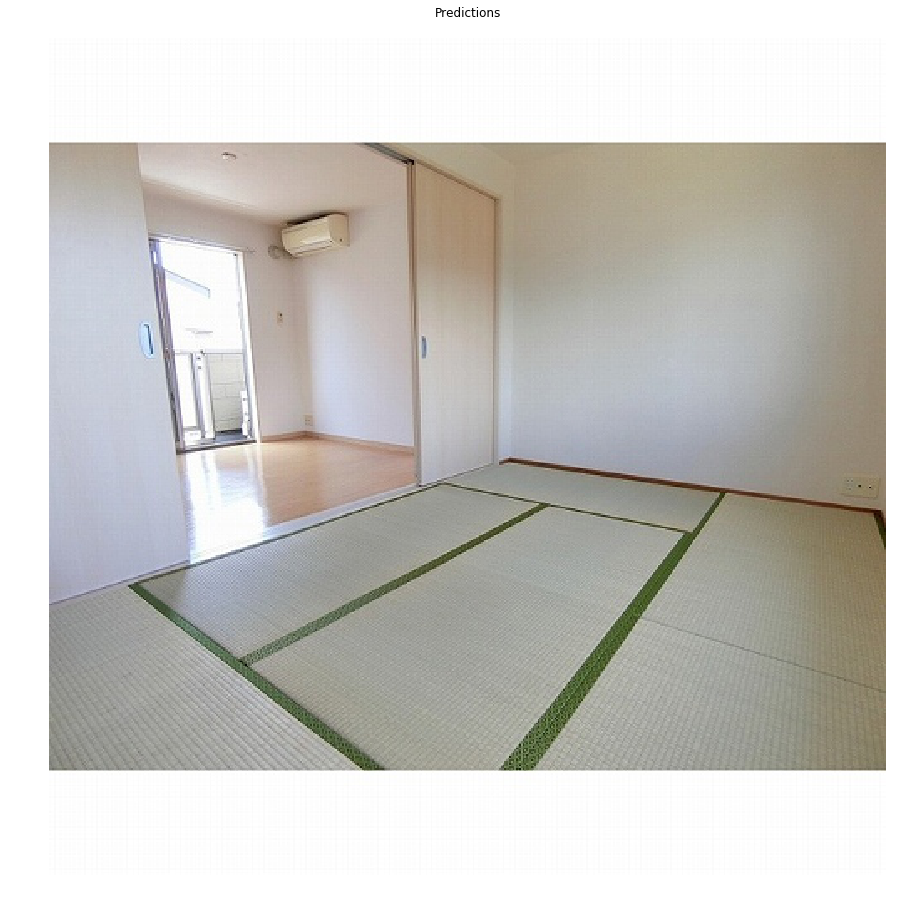

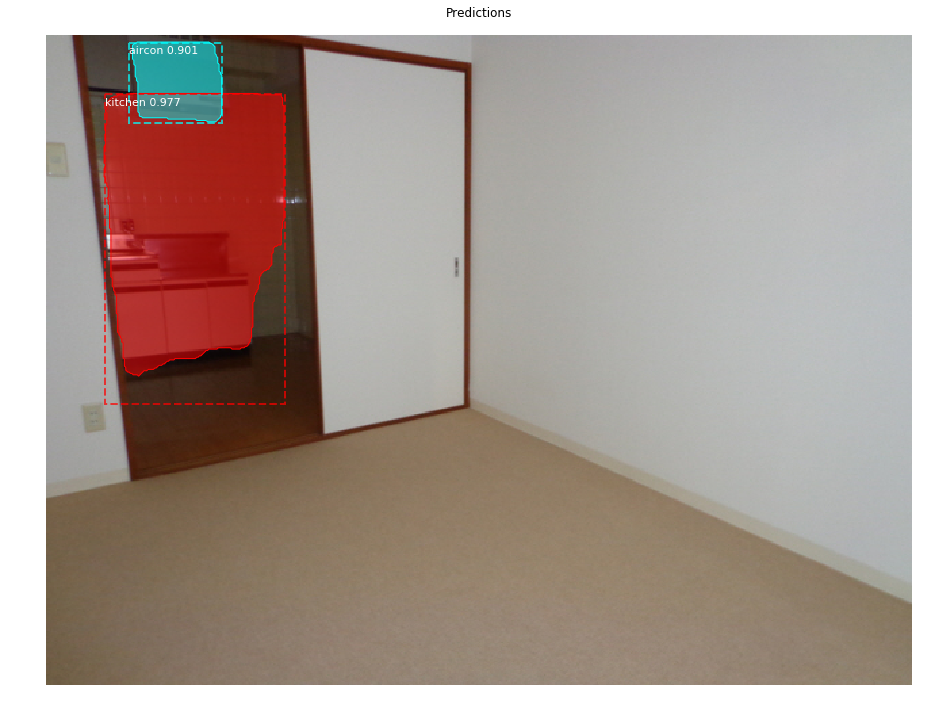

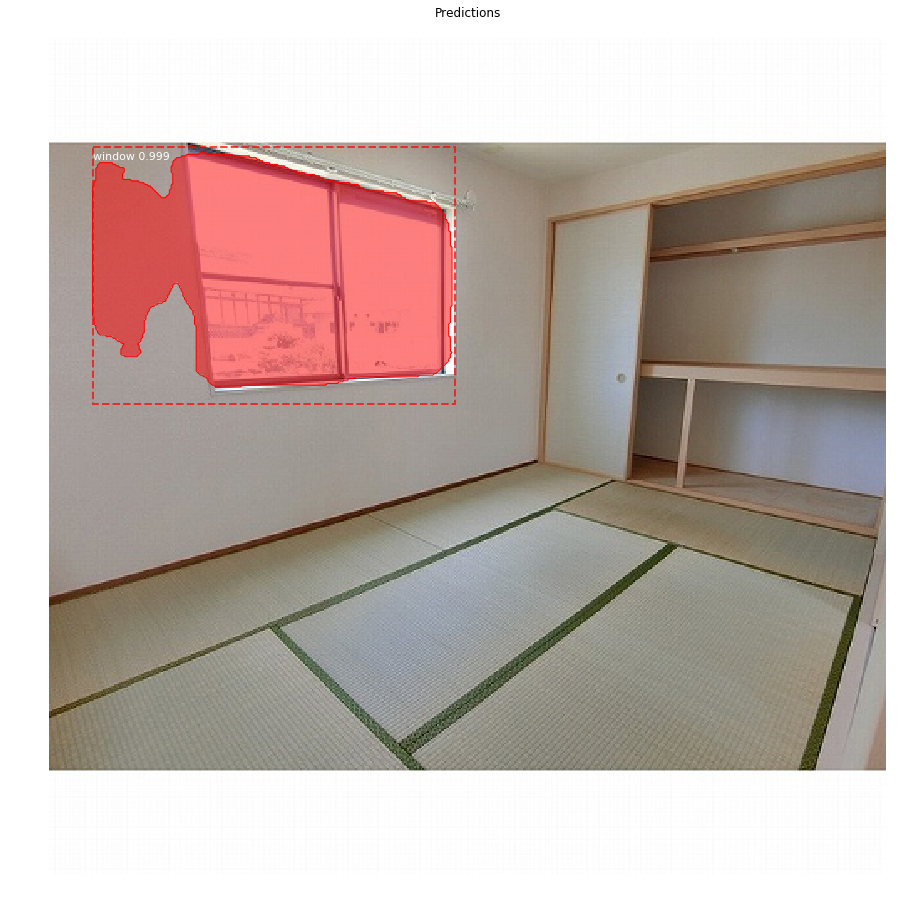

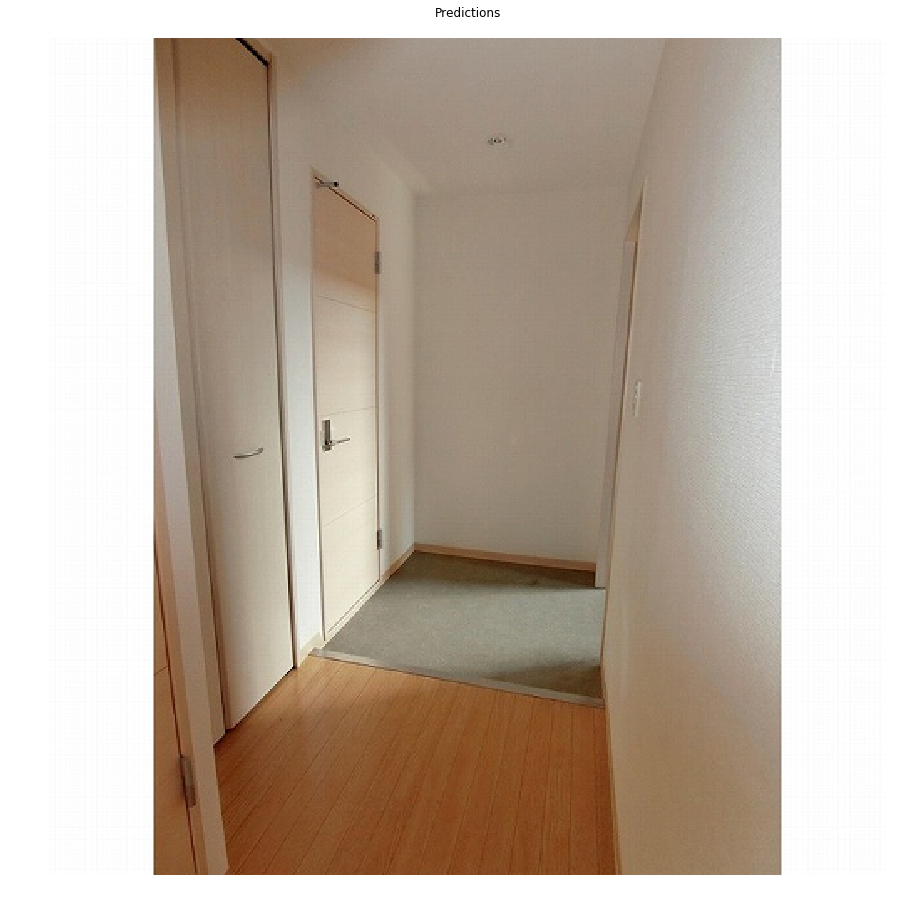

In [54]:
class_names = ['BG', 'window', 'balcony door', 'aircon', 'room door', 'kitchen', 'wardrobe', 'home door']

for img_file in os.listdir(image_path):

    # Run model detection and generate the color splash effect
    print("Running on {}".format(img_file))
    # Read image
    image = skimage.io.imread(os.path.join(image_path, img_file))

    # Run object detection
    results = model.detect([image], verbose=1)

    # Display results
    ax = get_ax(1)
    r = results[0]
    masked = visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                                class_names, r['scores'], ax=ax,
                                title="Predictions")
    
    plt.imsave('mask_results/mask_%s' % img_file, masked)
    ax.get_figure().savefig('mask_results/%s' % img_file)